## Знакомимся с matplotlib

In [ ]:
# Загрузка картинок
!mkdir media
!wget https://github.com/antoleb/cv_notebooks/raw/master/week1/media/bilateral_result.png -P media &> /dev/null
!wget https://github.com/antoleb/cv_notebooks/raw/master/week1/media/green_screen.png -P media &> /dev/null
!wget https://github.com/antoleb/cv_notebooks/raw/master/week1/media/image1.jpg -P media &> /dev/null
!wget https://github.com/antoleb/cv_notebooks/raw/master/week1/media/mask_portrait.png -P media &> /dev/null
!wget https://github.com/antoleb/cv_notebooks/raw/master/week1/media/moon.png -P media &> /dev/null
!wget https://github.com/antoleb/cv_notebooks/raw/master/week1/media/portrait.jpeg -P media &> /dev/null

### Работа с цветными изображениями

In [ ]:
import numpy as np # Изображения будут в формате np.array
import matplotlib # Для отрисовки

from matplotlib import pyplot as plt
from skimage import io # Для считываения

In [ ]:
img = io.imread('./media/image1.jpg')

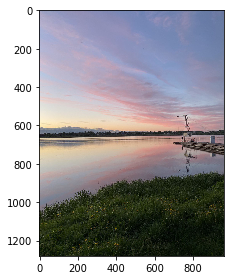

In [ ]:
io.imshow(img)

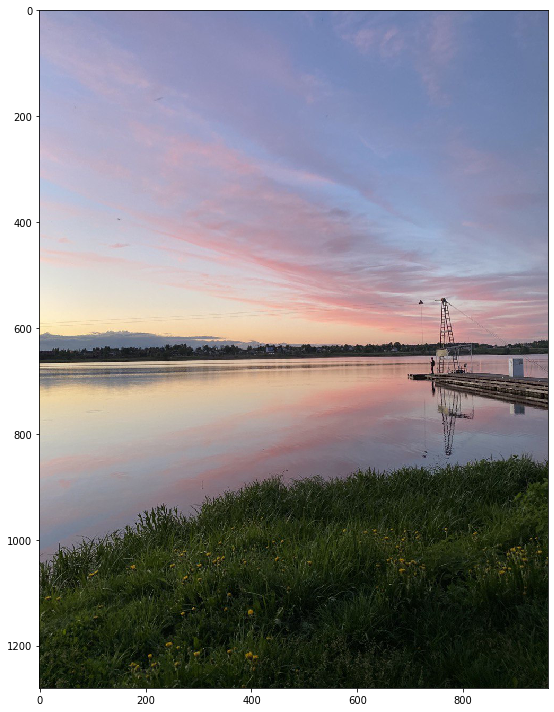

In [ ]:
#io.imshow на самом деле вызывает pyplot.imshow(...)

plt.figure(figsize=(10, 10))
io.imshow(img)

In [ ]:
# Зададим на будующее параметры матплотлиба

matplotlib.rcParams['figure.figsize'] = (20, 10)

In [ ]:
# Изображение это матрица
img

array([[[166, 167, 195],
        [164, 165, 193],
        [162, 163, 193],
        ...,
        [102, 117, 160],
        [104, 119, 162],
        [105, 120, 163]],

       [[165, 166, 194],
        [163, 164, 192],
        [162, 163, 193],
        ...,
        [102, 117, 160],
        [103, 118, 161],
        [104, 119, 162]],

       [[164, 165, 193],
        [163, 164, 194],
        [162, 163, 193],
        ...,
        [102, 117, 160],
        [102, 117, 160],
        [103, 118, 161]],

       ...,

       [[ 39,  43,  28],
        [ 37,  41,  26],
        [ 44,  48,  33],
        ...,
        [ 19,  25,  11],
        [ 21,  27,  13],
        [ 25,  31,  17]],

       [[ 33,  37,  23],
        [ 34,  38,  24],
        [ 40,  44,  30],
        ...,
        [ 18,  26,  11],
        [ 22,  30,  15],
        [ 24,  30,  16]],

       [[ 38,  41,  30],
        [ 41,  44,  33],
        [ 42,  45,  34],
        ...,
        [ 23,  31,  16],
        [ 23,  31,  16],
        [ 19,  27,  12]]

In [ ]:
print(img.min(),', ', img.max(), sep='')

0, 255


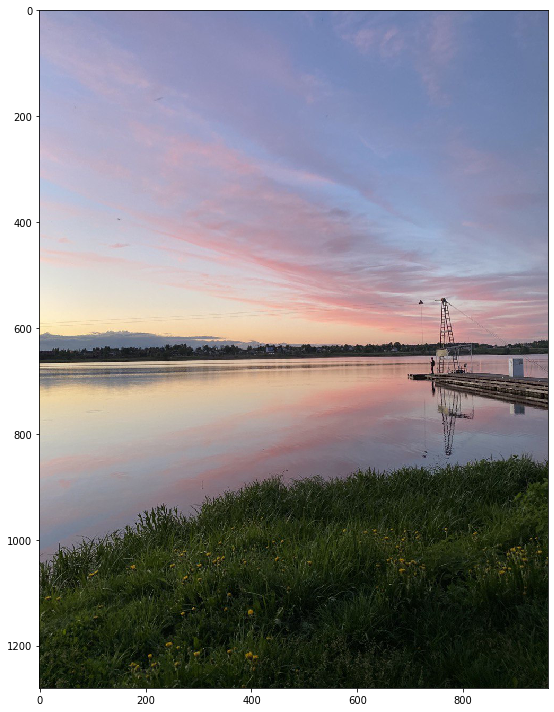

In [ ]:
# Можем перевести в тип флотов. Альтернативно можно воспользоваться skimage.img_as_float

img_float = img/255
io.imshow(img_float)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


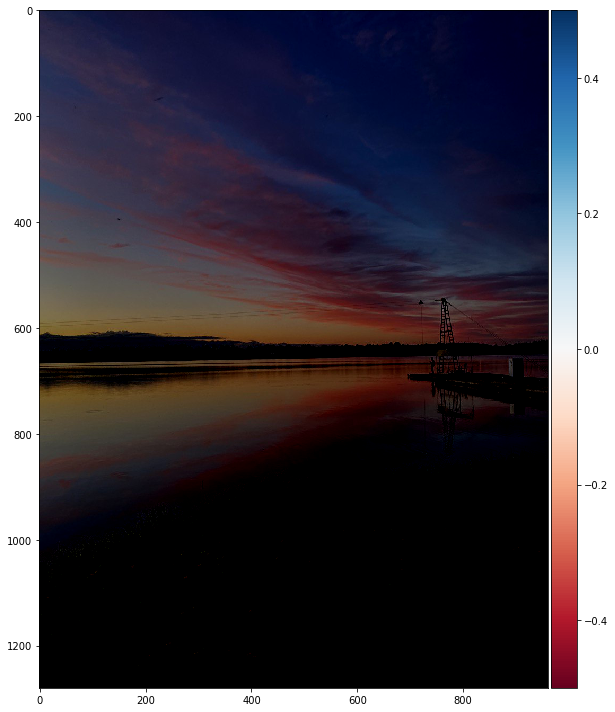

In [ ]:
# Играемся

io.imshow(img_float - .5)

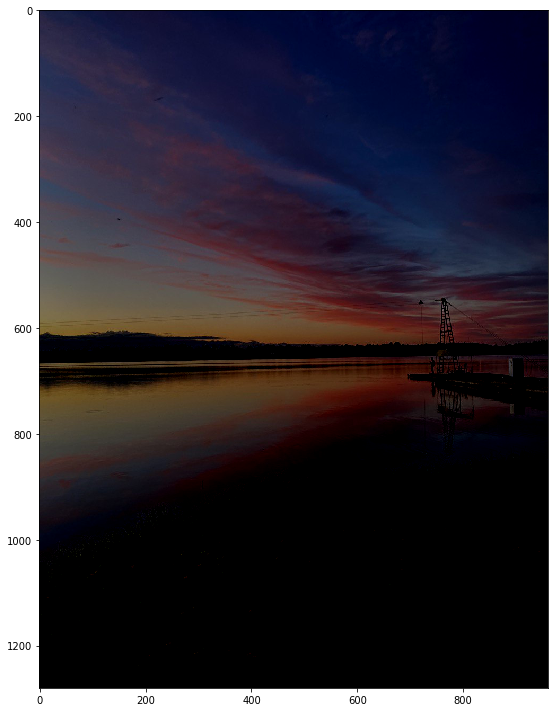

In [ ]:
io.imshow(np.clip(img_float - .5, 0, 1))

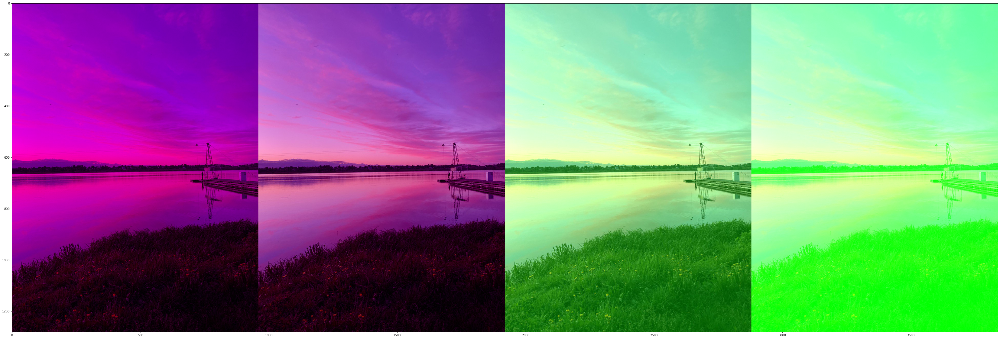

In [ ]:
plt.figure(figsize = (100,20))
new_img = img_float.copy()
concated = []
for gamma in np.linspace(-1, 1, 4):
    changed = new_img.copy()
    changed[..., 1] += gamma
    changed = np.clip(changed, 0, 1)
    concated.append(changed)
concated = np.concatenate(concated, 1)
plt.imshow(concated)

In [ ]:
from skimage import exposure

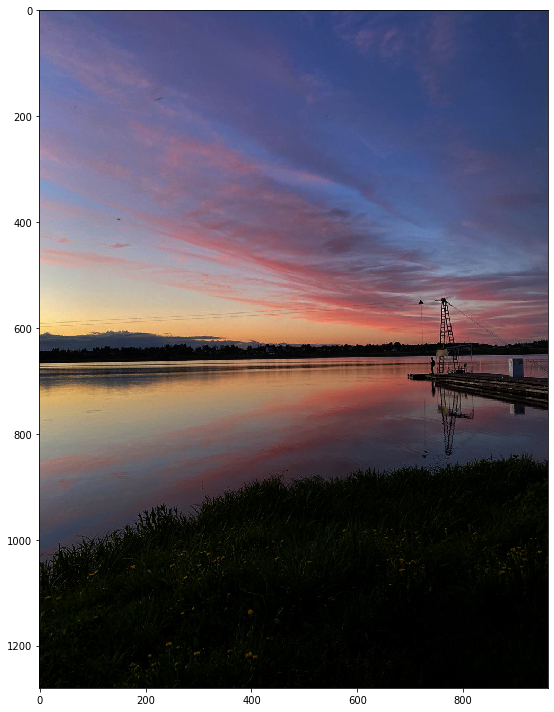

In [ ]:
gamma_corrected = exposure.adjust_gamma(img_float, gamma=2) # Гамма-коррекция
io.imshow(gamma_corrected)

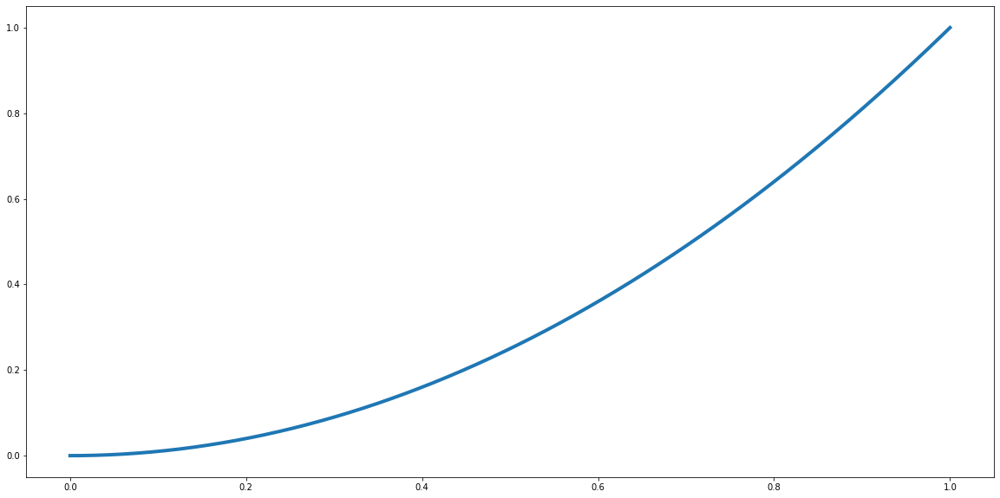

In [ ]:
dummmy_image = np.linspace(0, 1, 500)[None]
adjusted = exposure.adjust_gamma(dummmy_image, gamma=2)
plt.plot(dummmy_image[0], adjusted[0], linewidth=4) # Рисуем кривую для гамма-коррекции

In [ ]:
from skimage import color

In [ ]:
gray = color.rgb2gray(img)

In [ ]:
gray

array([[0.66198549, 0.65414235, 0.64686471, ..., 0.45848157, 0.46632471,
        0.47024627],
       [0.65806392, 0.65022078, 0.64686471, ..., 0.45848157, 0.46240314,
        0.46632471],
       [0.65414235, 0.65078627, 0.64686471, ..., 0.45848157, 0.45848157,
        0.46240314],
       ...,
       [0.16105294, 0.1532098 , 0.18066078, ..., 0.08908078, 0.09692392,
        0.1126102 ],
       [0.13780627, 0.14172784, 0.16525725, ..., 0.09105294, 0.10673922,
        0.10868863],
       [0.15517412, 0.16693882, 0.17086039, ..., 0.11066078, 0.11066078,
        0.09497451]])

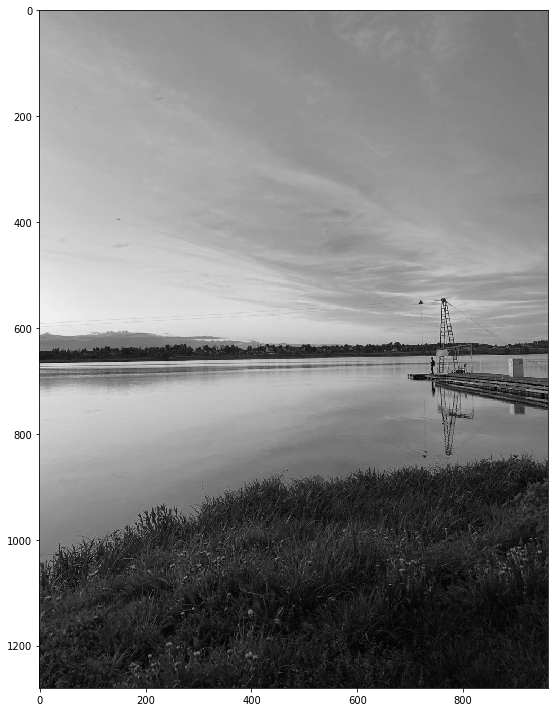

In [ ]:
io.imshow(gray)

In [ ]:
hsv_image = color.rgb2hsv(img) #Переводим в hsv

In [ ]:
for i in range(3):
    print(hsv_image[..., i].min(), hsv_image[..., i].max())

0.0 0.9977477477477478
0.0 1.0
0.0 1.0


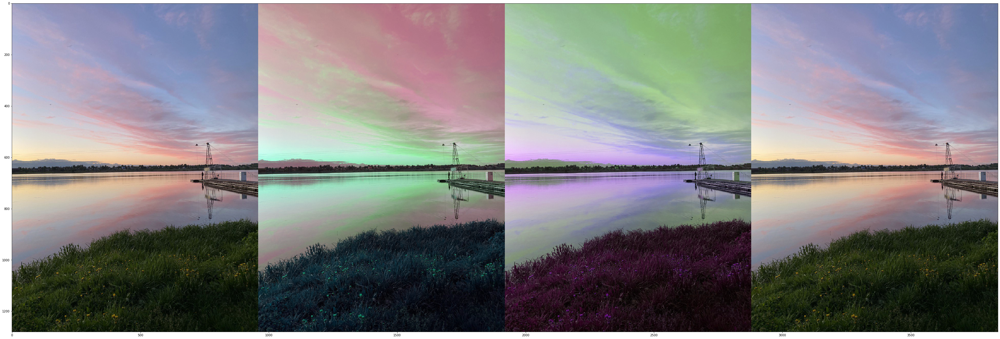

In [ ]:
plt.figure(figsize = (100,20))
hsv_image = color.rgb2hsv(img)
concated = []
for add in np.linspace(0, 1, 4):
    changed = hsv_image.copy()
    changed[..., 0] += add
    changed[changed[..., 0] > 1][..., 0] -= 1
    concated.append(changed)
concated = np.concatenate(concated, 1)
concated = color.hsv2rgb(concated)
plt.imshow(concated, interpolation='nearest')

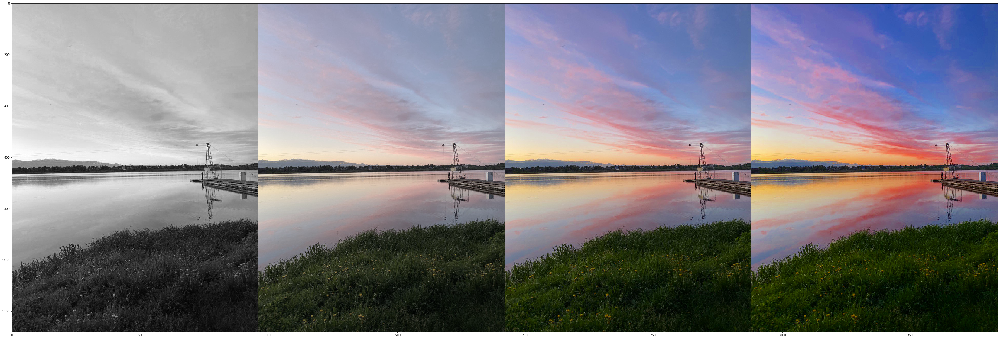

In [ ]:
plt.figure(figsize = (100,20))
hsv_image = color.rgb2hsv(img)
concated = []
for mul in np.linspace(0, 2, 4):
    changed = hsv_image.copy()
    changed[..., 1] *= mul
    changed[..., 1] = np.clip(changed[..., 1], 0, 1)
    concated.append(changed)
concated = np.concatenate(concated, 1)
concated = color.hsv2rgb(concated)
plt.imshow(concated, interpolation='nearest')

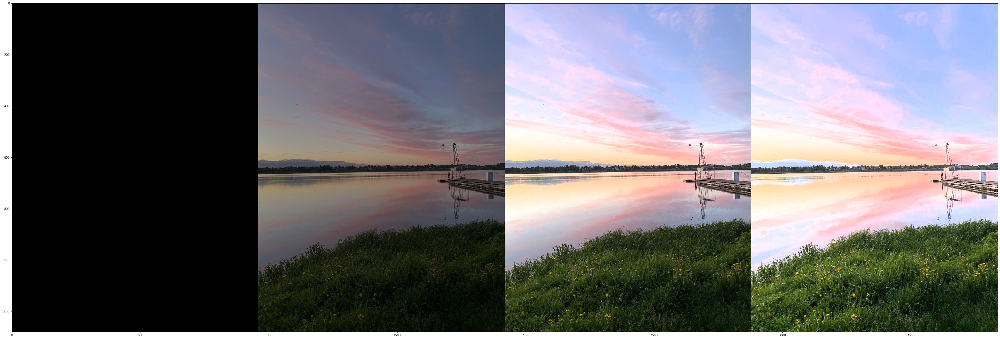

In [ ]:
plt.figure(figsize = (100,20))
hsv_image = color.rgb2hsv(img)
concated = []
for mul in np.linspace(0, 2, 4):
    changed = hsv_image.copy()
    changed[..., 2] *= mul
    changed[..., 2] = np.clip(changed[..., 2], 0, 1)
    concated.append(changed)
concated = np.concatenate(concated, 1)
concated = color.hsv2rgb(concated)
plt.imshow(concated, interpolation='nearest')

### Задача зелёного экрана

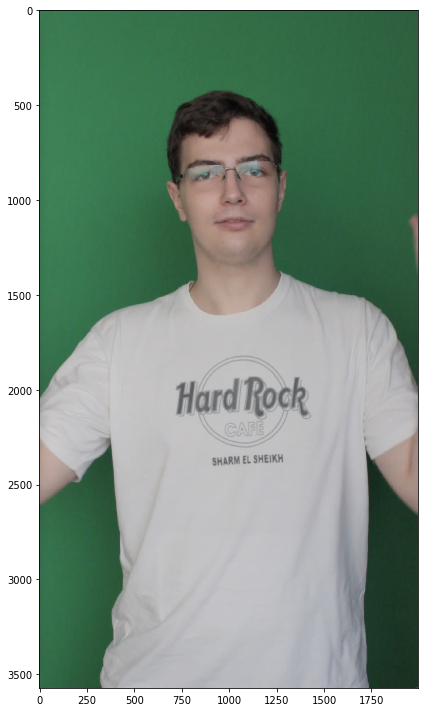

In [ ]:
from skimage import transform, img_as_float

# Заменим фон у изображения на зеленом фоне
green_screen_img = io.imread('./media/green_screen.png')[..., :3]
green_screen_img = img_as_float(green_screen_img)

io.imshow(green_screen_img)

Text(0.5, 1.0, 'hue distribution')

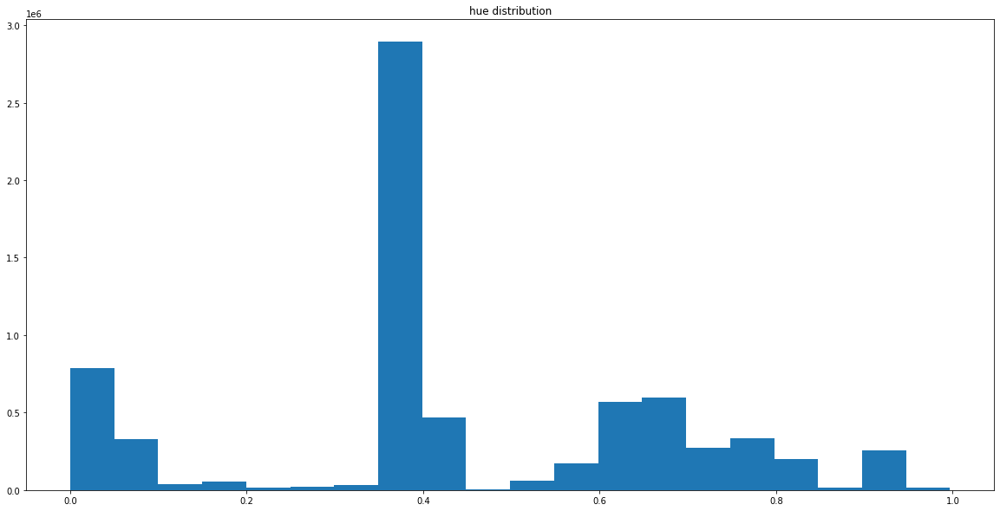

In [ ]:
# Посмотрим на распределение пикселей

hsv_img = color.rgb2hsv(green_screen_img[..., :3])
plt.hist(hsv_img[..., 0].reshape(-1), bins=20)
plt.title('hue distribution')

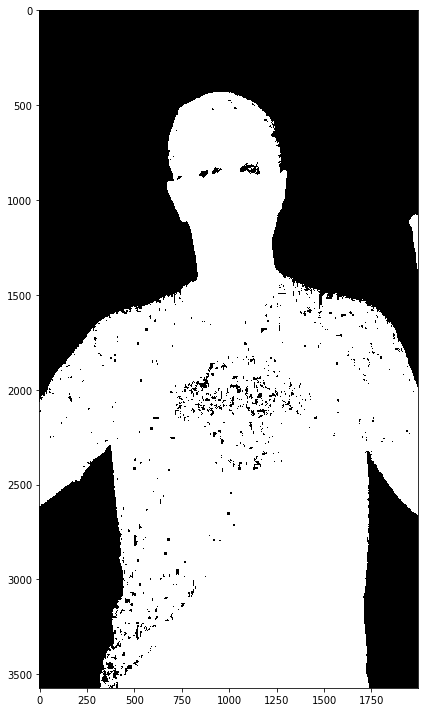

In [ ]:
mask = (hsv_img[..., 0] < .3) | (hsv_img[..., 0] > .5)
io.imshow(mask.astype(float))

In [ ]:
from skimage import morphology # Модуль для работы с бинарными изображениями

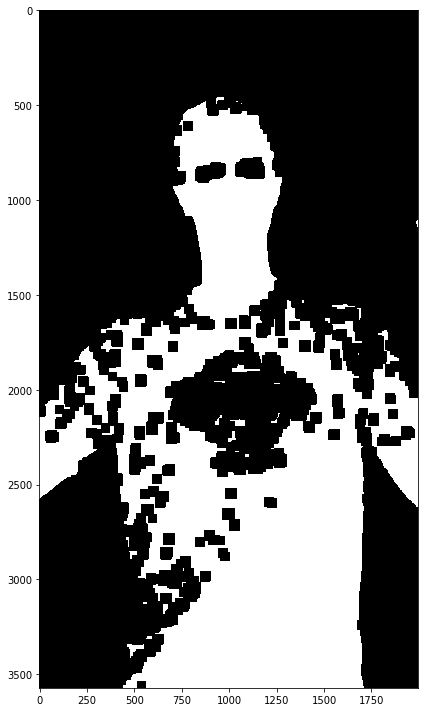

In [ ]:
# Играемся

io.imshow(morphology.binary_erosion(mask, selem=np.ones([50, 50])).astype(float))

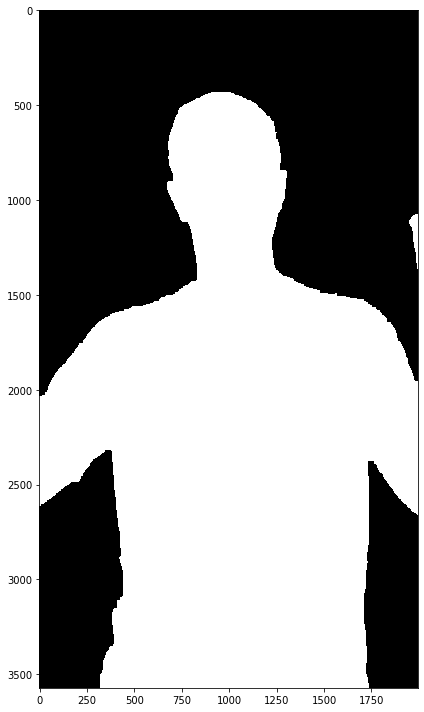

In [ ]:
opened = morphology.binary_closing(mask, selem=np.ones([30, 30])).astype(float)
io.imshow(opened)

In [ ]:
print(img_float.shape)
print(green_screen_img.shape)

(1280, 960, 3)
(3572, 1994, 3)


In [ ]:
from skimage import transform # нужно для приведения к одному размеру

background = transform.resize(img_float, green_screen_img.shape[:2])

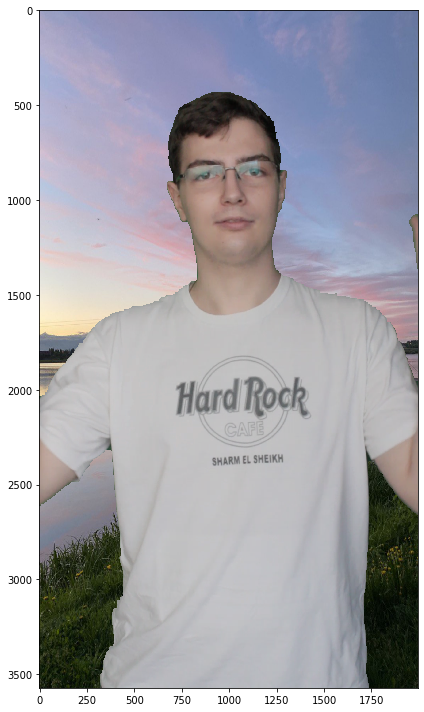

In [ ]:
changed_background = green_screen_img * opened[..., None] + background * (1- opened[..., None])
io.imshow(changed_background)

### Свёртки

In [ ]:
from scipy.signal import convolve2d # Нужно для сверток

In [ ]:
# Создадим ядро
kernel = np.ones([9, 9])
kernel /= kernel.sum()
kernel

array([[0.01234568, 0.01234568, 0.01234568, 0.01234568, 0.01234568,
        0.01234568, 0.01234568, 0.01234568, 0.01234568],
       [0.01234568, 0.01234568, 0.01234568, 0.01234568, 0.01234568,
        0.01234568, 0.01234568, 0.01234568, 0.01234568],
       [0.01234568, 0.01234568, 0.01234568, 0.01234568, 0.01234568,
        0.01234568, 0.01234568, 0.01234568, 0.01234568],
       [0.01234568, 0.01234568, 0.01234568, 0.01234568, 0.01234568,
        0.01234568, 0.01234568, 0.01234568, 0.01234568],
       [0.01234568, 0.01234568, 0.01234568, 0.01234568, 0.01234568,
        0.01234568, 0.01234568, 0.01234568, 0.01234568],
       [0.01234568, 0.01234568, 0.01234568, 0.01234568, 0.01234568,
        0.01234568, 0.01234568, 0.01234568, 0.01234568],
       [0.01234568, 0.01234568, 0.01234568, 0.01234568, 0.01234568,
        0.01234568, 0.01234568, 0.01234568, 0.01234568],
       [0.01234568, 0.01234568, 0.01234568, 0.01234568, 0.01234568,
        0.01234568, 0.01234568, 0.01234568, 0.01234568],


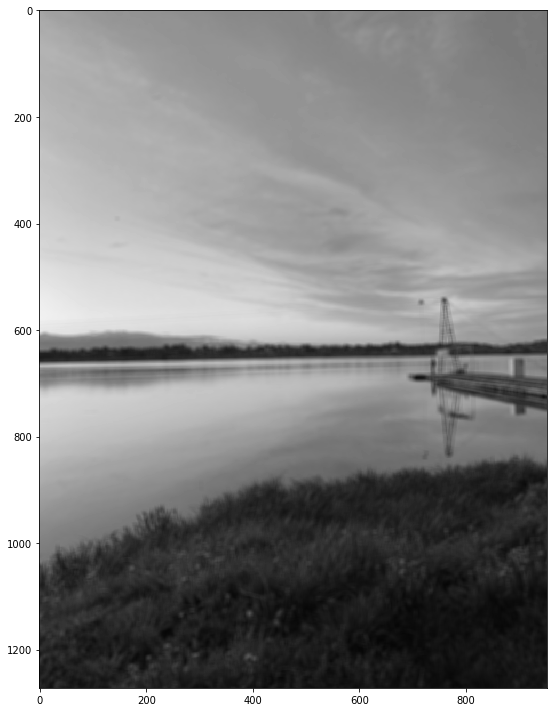

In [ ]:
colvolved = convolve2d(gray, kernel, mode='valid')
colvolved = np.clip(colvolved, 0, 1)
io.imshow(colvolved)

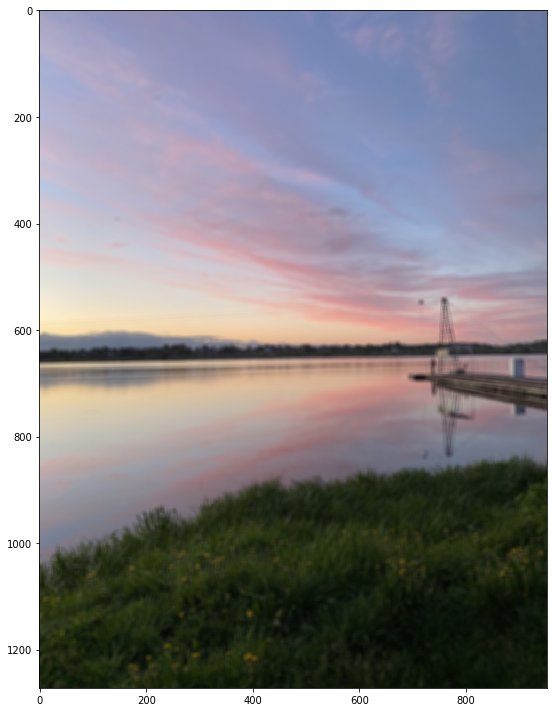

In [ ]:
convolved_color = np.concatenate([
    convolve2d(img_float[..., i], kernel, mode='valid')[..., None] for i in range(3)
], -1)
convolved_color = np.clip(convolved_color, 0, 1)
io.imshow(convolved_color)

In [ ]:
from skimage import filters

/tmp/ipykernel_1762/1777295231.py:1: RuntimeWarning: Images with dimensions (M, N, 3) are interpreted as 2D+RGB by default. Use `multichannel=False` to interpret as 3D image with last dimension of length 3.
  gaussian_filtered = filters.gaussian(img_float)


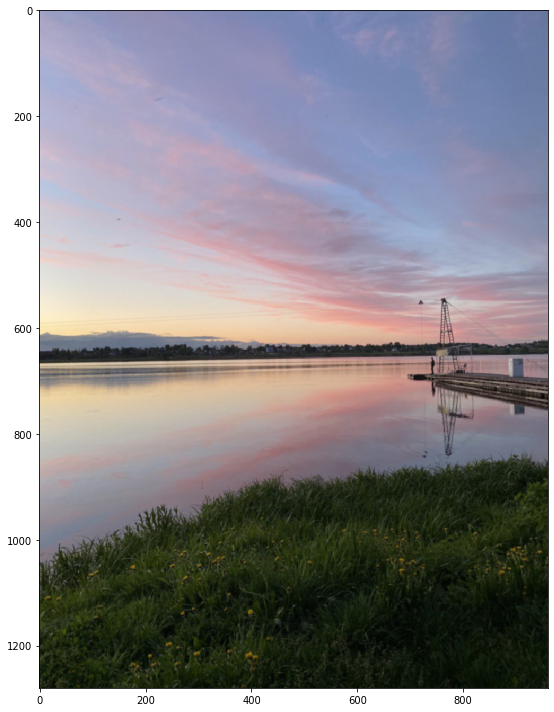

In [ ]:
gaussian_filtered = filters.gaussian(img_float)
io.imshow(gaussian_filtered)

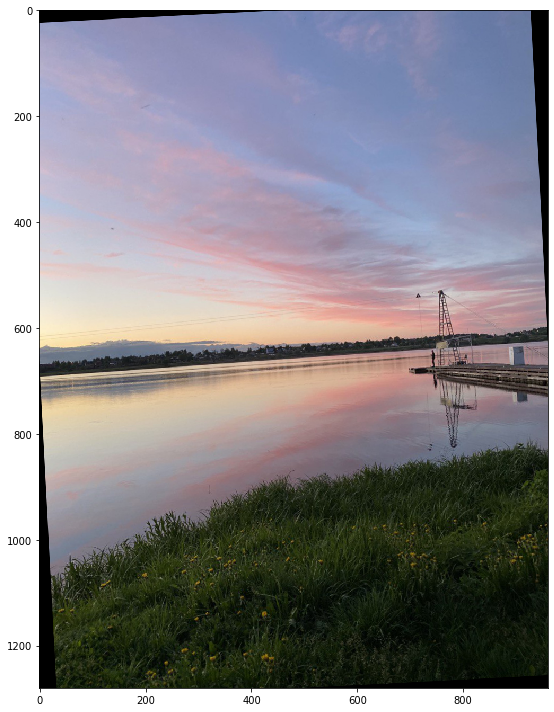

In [ ]:
io.imshow(transform.rotate(img_float, 3))

### Гистограммы

In [ ]:
moon = io.imread('./media/moon.png')

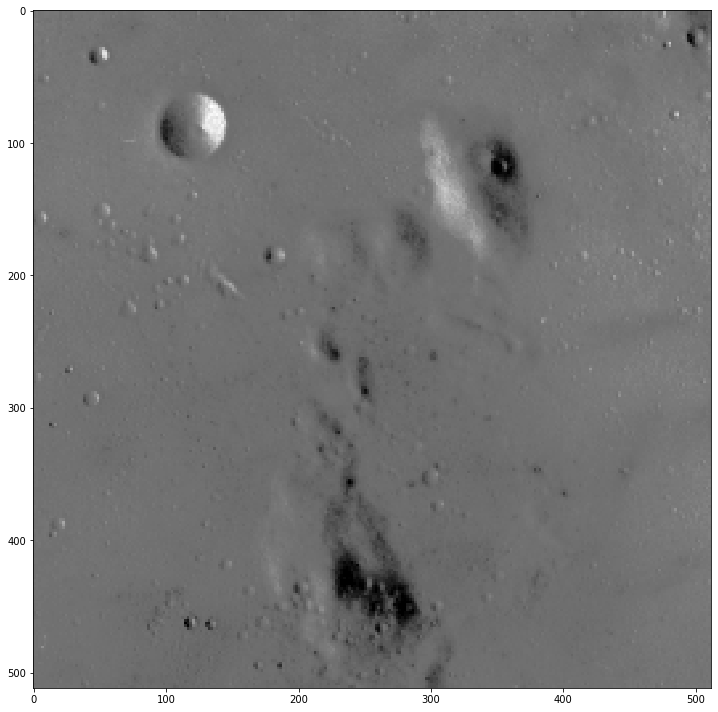

In [ ]:
io.imshow(moon)

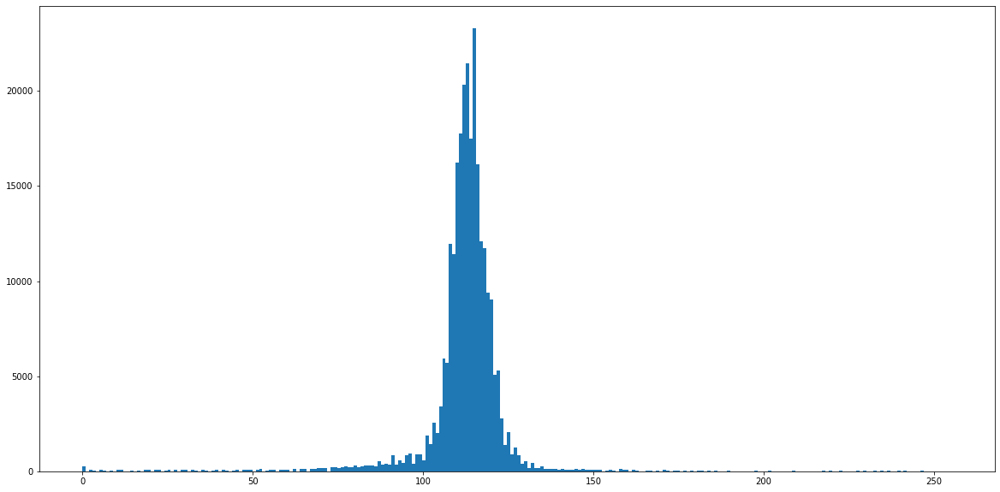

In [ ]:
plt.hist(moon.ravel(), bins=256);

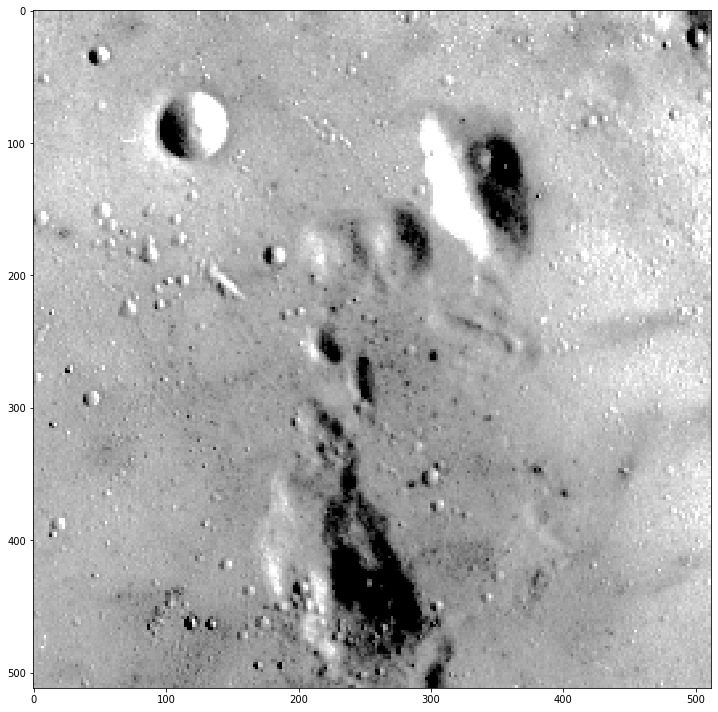

In [ ]:
p2, p98 = np.percentile(moon, (2, 98))
rescaled = exposure.rescale_intensity(moon, in_range=(p2, p98))
io.imshow(rescaled)

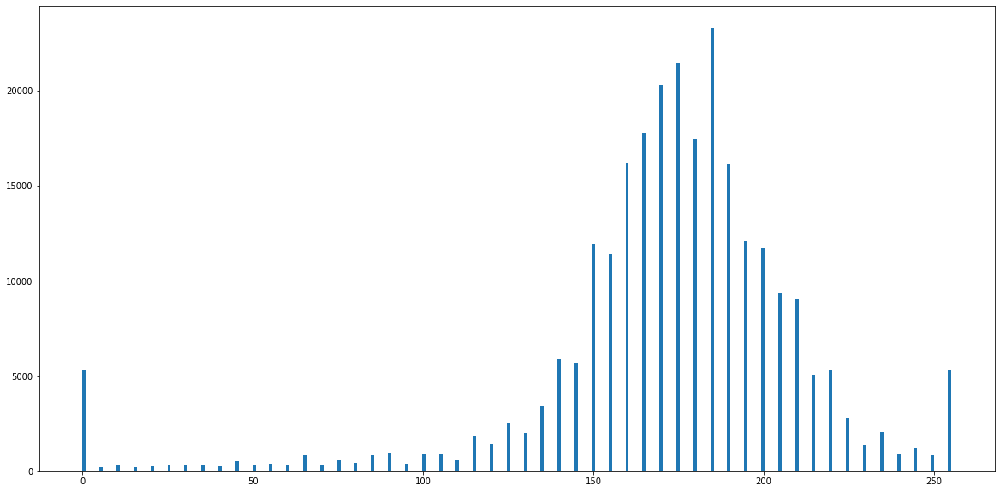

In [ ]:
plt.hist(rescaled.ravel(), bins=256);

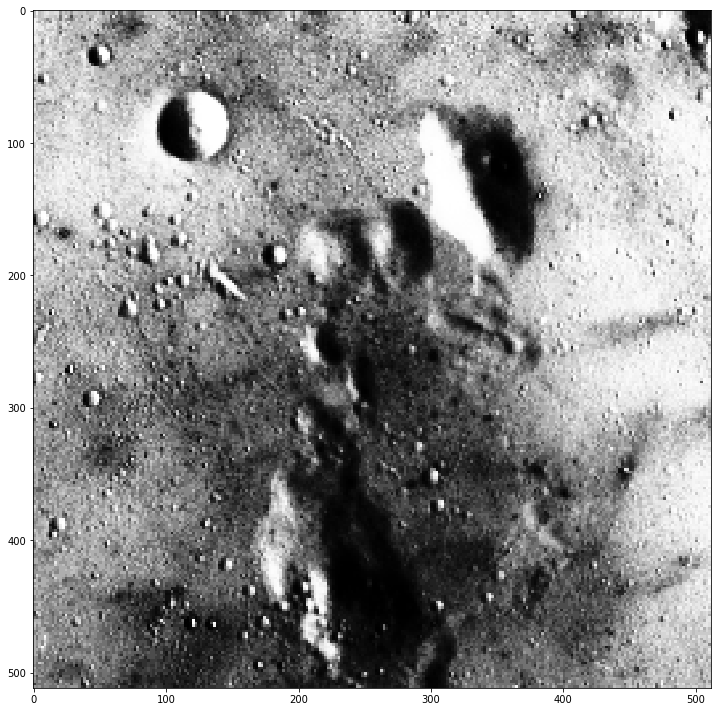

In [ ]:
equalized_hist = exposure.equalize_hist(moon)
io.imshow(equalized_hist)

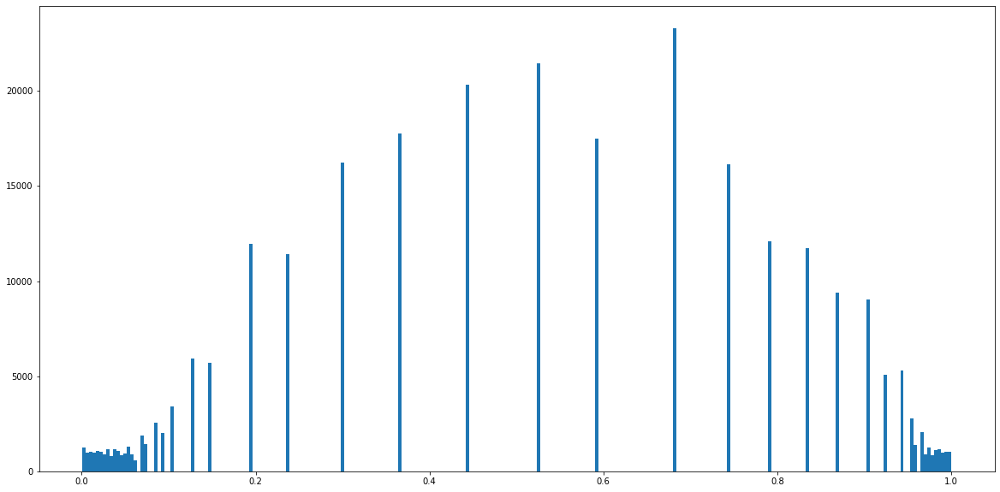

In [ ]:
plt.hist(equalized_hist.ravel(), bins=256);

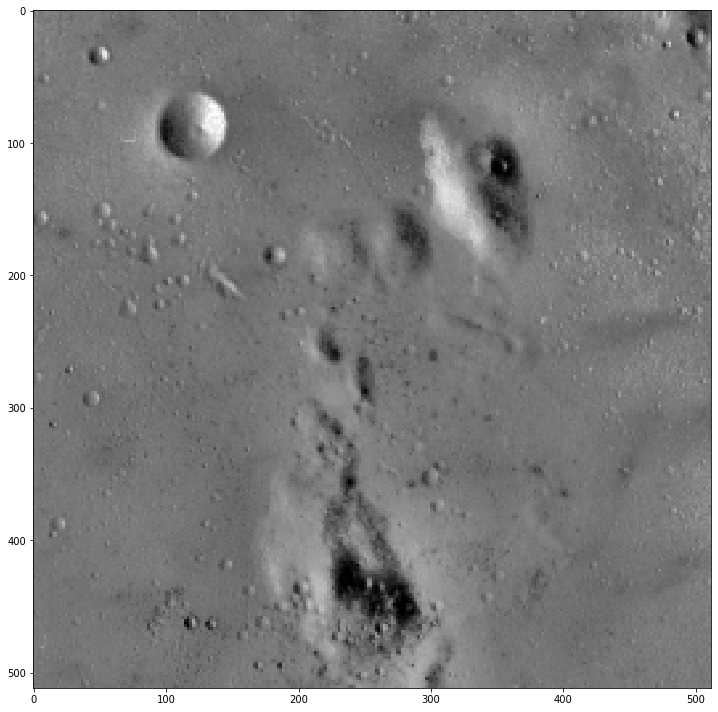

In [ ]:
equalized_adapt_hist = exposure.equalize_adapthist(moon)
io.imshow(equalized_adapt_hist)